<h1>Explanation of the feature impact on every country in the data set</h1>

In [1]:
import numpy as np
import pandas as pd
from xgboost import XGBRegressor
import shap
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import settings

In [2]:
xgb_all = XGBRegressor(gamma = 0,
                       learning_rate = 0.5, 
                       max_depth = 2,
                       min_child_weight = 6, 
                       n_estimators = 50,
                       random_state=0)

In [3]:
unscaled_food = pd.read_csv(f'{settings.output_folder}diet_unscaled.csv')
unscaled_comorbidity = pd.read_csv(f'{settings.output_folder}icd_10.csv')
unscaled_comorbidity = unscaled_comorbidity[unscaled_comorbidity.columns[1:]]
unscaled_development = pd.read_csv(f'{settings.raw_data_folder}control/control_data_unscaled.csv')
unscaled_development.dropna(inplace=True)
unscaled_development['Undernourished'] = [float(val) if val != '<2.5' else 2.5 for val in unscaled_development.Undernourished]
unscaled_food = unscaled_food[unscaled_food.columns[1:]]
unscaled_food.drop(['Population', 'Active', 'Obesity'], axis=1, inplace=True)
unscaled_data = unscaled_food.merge(unscaled_comorbidity, on='Country', how='inner')
unscaled_data = unscaled_data.merge(unscaled_development, on='Country', how='inner')
targets = pd.read_csv(f'{settings.raw_data_folder}control/regression_targets.csv')
unscaled_train = unscaled_data.merge(targets, on='Country', how='inner')

label_values = ['Deaths', 'Recovered', 'Confirmed']
X_unscaled = unscaled_train[unscaled_train.columns.drop(label_values)]
countries = X_unscaled.Country
X_unscaled = X_unscaled[X_unscaled.columns.drop('Country')]

In [9]:
pd.set_option('display.max_columns', 65)
X_unscaled.describe()

,Alcoholic Beverages,Animal Products,Animal fats,"Aquatic Products, Other",Cereals - Excluding Beer,Eggs,"Fish, Seafood",Fruits - Excluding Wine,Meat,Miscellaneous,Milk - Excluding Butter,Offals,Oilcrops,Pulses,Spices,Starchy Roots,Stimulants,Sugar Crops,Sugar & Sweeteners,Treenuts,Vegetal Products,Vegetable Oils,Vegetables,"Endocrine, nutritional and metabolic diseases",Mental and behavioural disorders,Diseases of the nervous system,Diseases of the eye and adnexa and ear and mastoid process,Diseases of the circulatory system,Diseases of the respiratory system,Diseases of the digestive system,Diseases of the skin and subcutaneous tissue,Diseases of the musculoskeletal system and connective tissue,Diseases of the genitourinary system,"Pregnancy, childbirth and the puerperium",Certain conditions originating in the perinatal period,"Congenital malformations, deformations and chromosomal abnormalities","Symptoms, signs and abnormal clinical and laboratory findings, not elsewhere classified",External causes of morbidity and mortality,infectious and parasitic diseases,Neoplasms,Obesity,Undernourished,Population,Annual Average Temperature,Max Latitude,Min Latitude,Max Longitude,Min Longitude,HDI Rank,hdi_2016,hdi_2017,hdi_2018,hdi_2019,gdp_2016,gdp_2017,gdp_2018,gdp_2019,Winter Average Temperature,Spring Average Temperature,Summer Average Temperature,Autumn Average Temperature
count,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,8.700000e+01,87.000000,87.000000,87.000000,8.700000e+01,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000,87.000000
mean,1.706152,16.765753,2.497239,0.001433,10.339009,0.824898,0.939657,2.748501,6.112131,0.209546,6.238213,0.151217,1.048852,0.402356,0.172265,1.817714,0.516295,0.017704,2.962508,0.446589,33.233609,8.110937,2.737413,8944.109770,4955.895785,7625.999808,22.615326,65774.589655,21313.415709,9416.947893,538.341762,1071.506513,5660.951916,149.548276,1870.335632,1226.293487,10129.781992,3134.627586,1.937362e+05,45333.589655,23.691954,5.597701,2.934326e+07,16.657594,32.936522,18.947356,19.922089,-11.091839,61.494253,0.807736,0.810494,0.812920,0.815345,2.616092,2.877011,2.581609,1.782759,11.617546,19.028541,21.933973,14.050317
std,1.030353,4.899985,1.760372,0.005104,3.546845,0.379966,0.938927,1.427236,2.081911,0.322589,2.860439,0.115597,1.725719,0.385086,0.257083,1.729148,0.396046,0.098756,0.888117,0.433449,4.899797,2.775271,1.392915,20148.572363,17093.942649,22117.279773,38.562647,130159.943537,54049.405264,19290.158244,1101.243967,2501.048116,12197.955899,338.598402,3568.623775,2184.252445,21624.856964,7152.789646,3.856236e+05,109402.263176,6.006667,4.655104,5.033062e+07,9.090989,24.972137,30.902115,69.679382,69.972470,38.800286,0.090260,0.090528,0.090781,0.090789,3.460974,3.203693,3.259495,4.704110,12.854038,7.839824,6.762227,11.004335
min,0.000233,6.479067,0.130533,0.000000,5.423933,0.153300,0.032200,0.473600,1.174600,0.000000,0.367667,0.000633,0.035500,0.000333,0.000300,0.331700,0.039467,0.000000,0.761367,0.005433,22.279300,2.023100,0.469400,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,4.400000,2.500000,7.200000e+04,-17.267477,-30.100000,-59.470000,-88.220000,-180.000000,1.000000,0.561000,0.562000,0.564000,0.567000,-17.000000,-15.700000,-19.600000,-35.000000,-28.318727,-12.158212,-5.009364,-23.583606
25%,0.943267,13.373567,1.023933,0.000000,7.601367,0.578000,0.401967,1.819500,4.845017,0.014800,3.888617,0.088567,0.349500,0.133400,0.034400,1.081783

In [4]:
X_train, X_test, Y_train, Y_test = train_test_split(X_unscaled, 
                                                    unscaled_train['Deaths'], 
                                                    test_size = 0.15, 
                                                    random_state = 0)

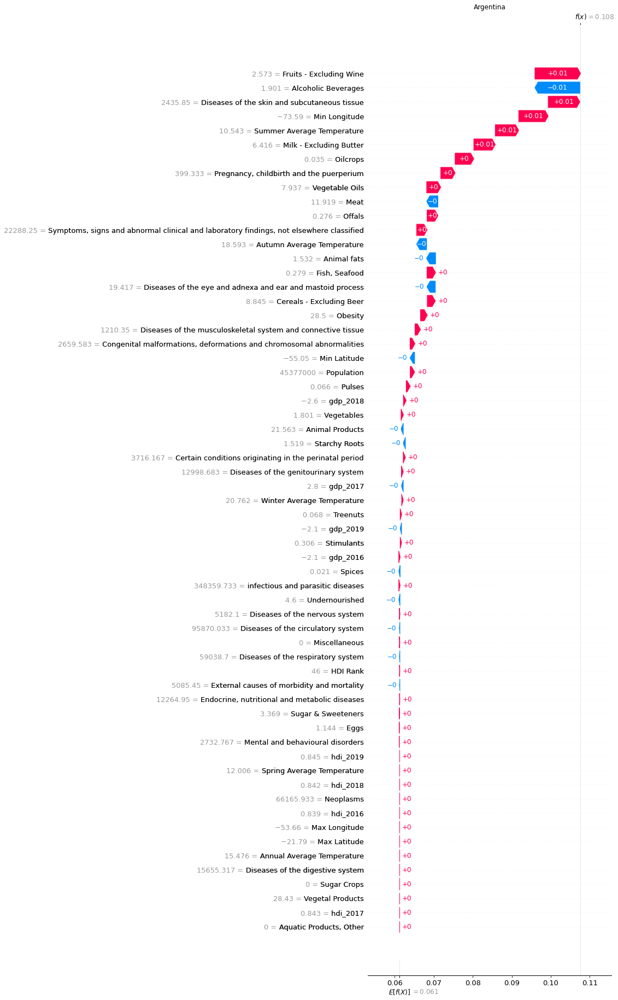

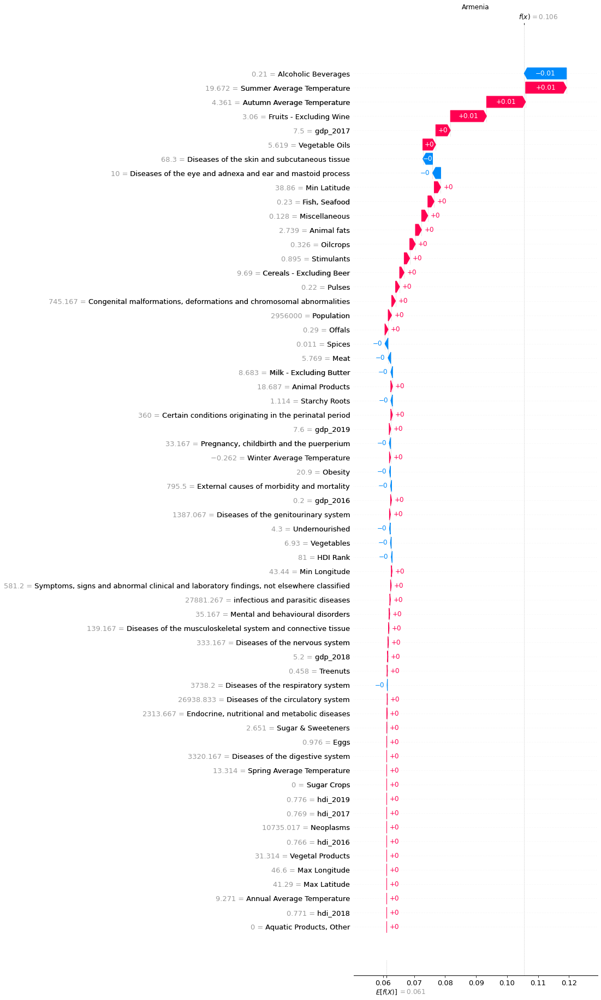

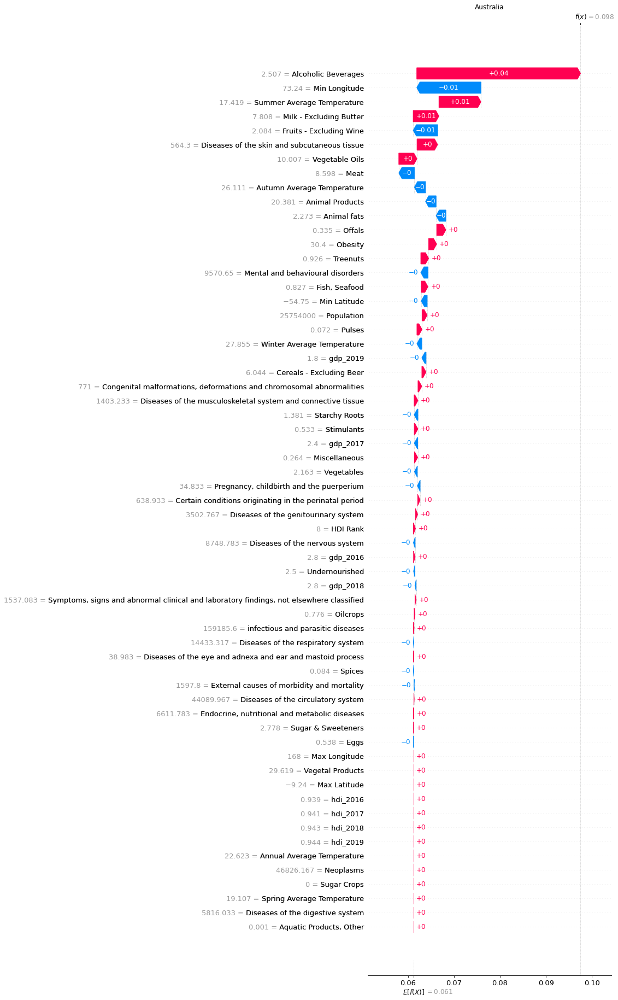

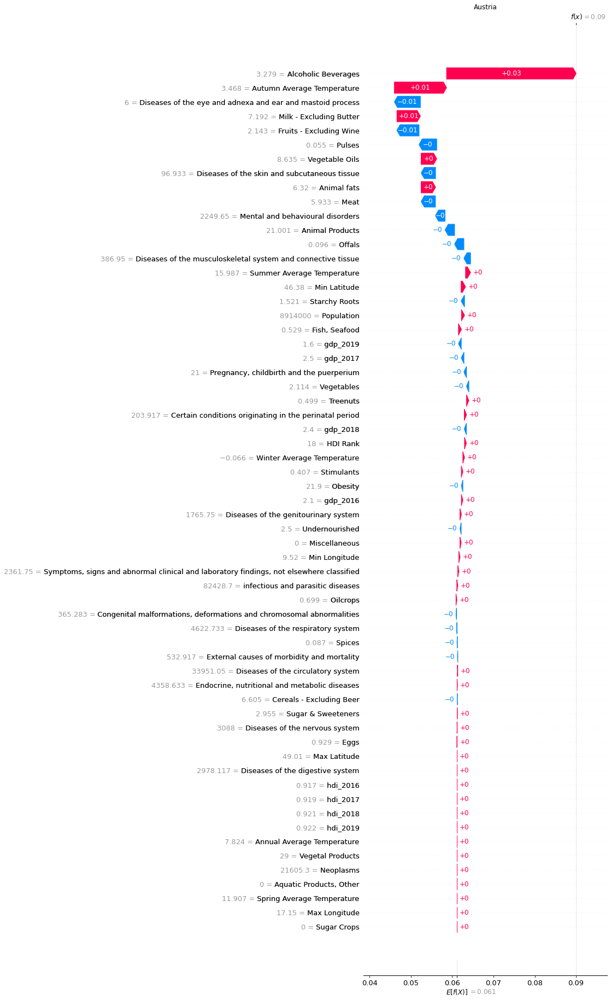

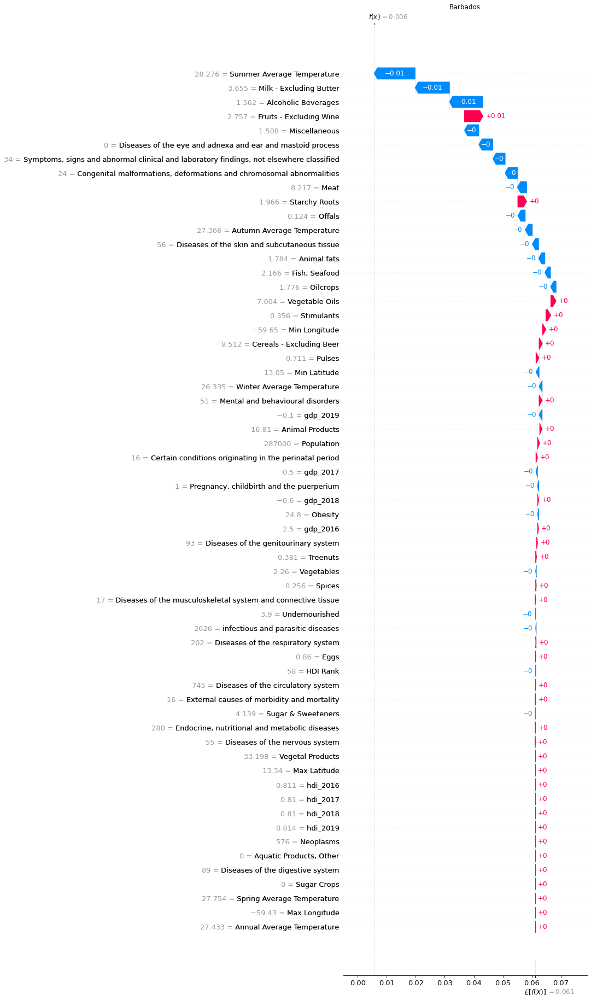

...

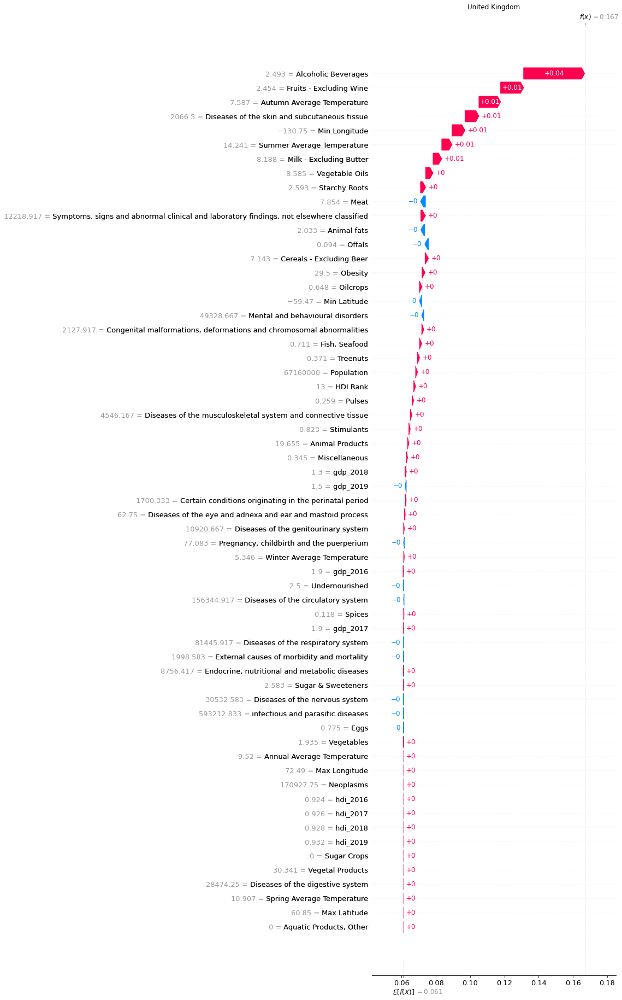

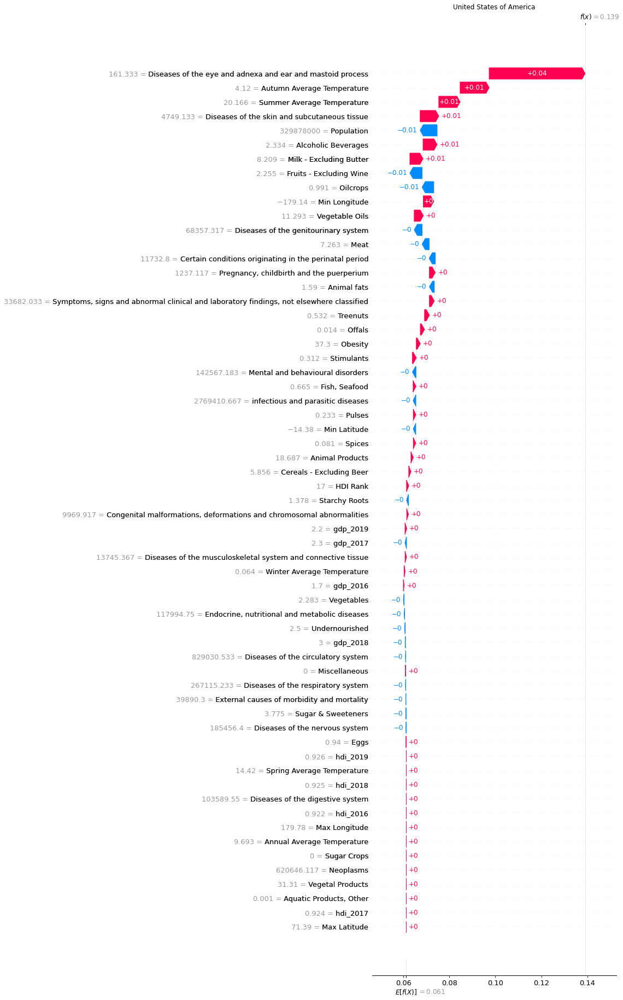

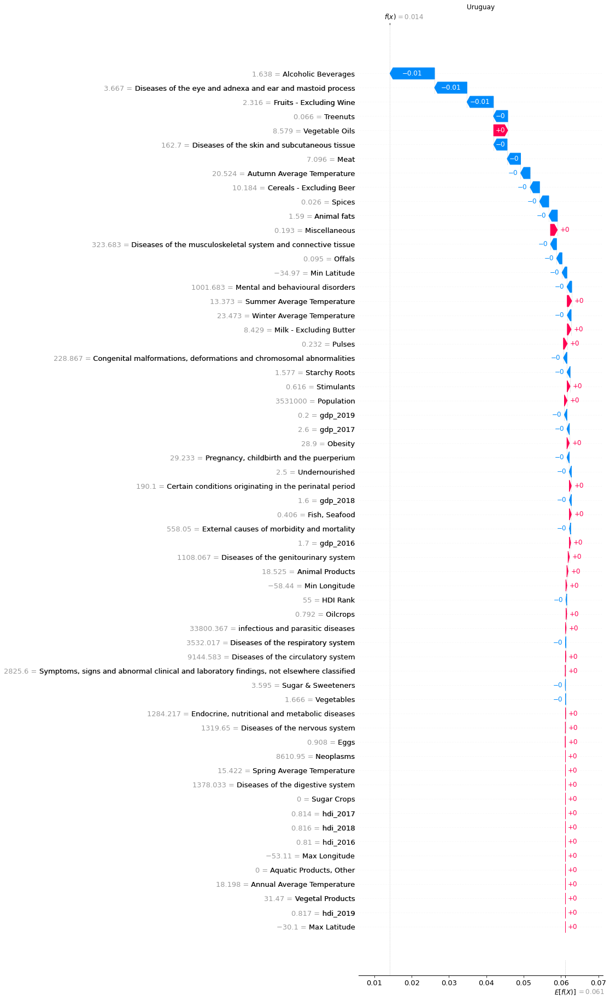

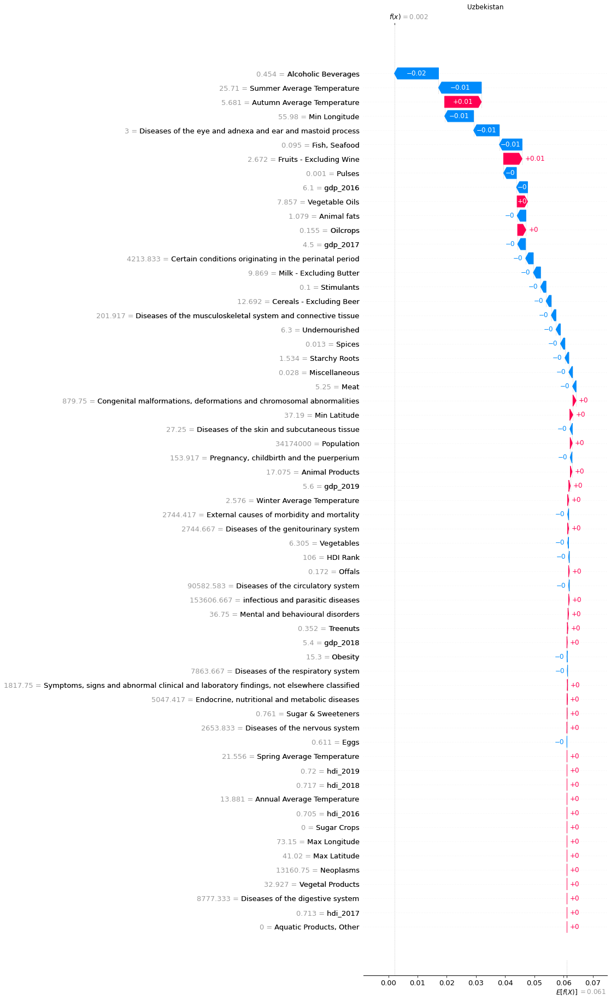

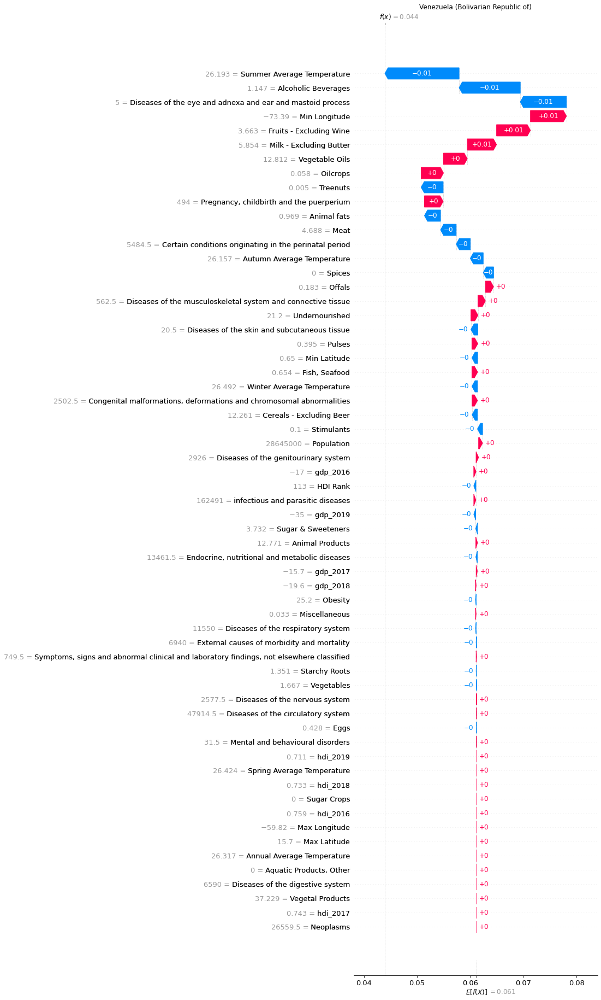

In [5]:
xgb_all.fit(X_train, Y_train)
expl = shap.Explainer(xgb_all, X_unscaled)
shap_values = expl(X_unscaled)

for val, country in zip(shap_values, countries):
    plt.title(country)
    shap.plots.waterfall(val, max_display=100)